In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
warnings.filterwarnings("ignore")
%pip install nbconvert[webpdf]
--allow-chromium-download


[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.


NameError: name 'allow' is not defined

In [2]:
df = pd.read_csv("C:/Users/manul/OneDrive/Escritorio/Analytics/Projects/psyco.csv")

In [3]:
df.head()

,age,gender,occupation,line_of_work,time_bp,time_dp,travel_time,easeof_online,home_env,prod_inc,...,fam_connect,relaxed,self_time,like_hw,dislike_hw,prefer,certaindays_hw,Unnamed: 19,time_bp.1,travel+work
0,19-25,Male,Student in College,NaN,7,5,0.5,3,3,0.0,...,1.0,-0.5,-0.5,100,1,Complete Physical Attendance,Yes,NaN,7,NaN
1,Dec-18,Male,Student in School,NaN,7,11,0.5,4,2,-0.5,...,1.0,1.0,1.0,1111,1110,Complete Physical Attendance,No,NaN,7,NaN
2,19-25,Male,Student in College,NaN,7,7,1.5,2,2,1.0,...,0.5,0.5,0.5,1100,111,Complete Physical Attendance,Yes,NaN,7,NaN
3,19-25,Male,Student in College,NaN,7,7,1.5,3,1,0.0,...,0.0,-1.0,-0.5,100,1111,Complete Physical Attendance,Yes,NaN,7,NaN
4,19-25,Female,Student in College,NaN,7,7,1.5,2,2,0.0,...,0.0,0.5,0.0,1010,1000,Complete Physical Attendance,Yes,NaN,7,NaN


In [4]:
df.shape

(1175, 22)

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
time_bp,1175.0,7.415319,2.005385,4.0,5.0,7.0,9.0,12.0
time_dp,1175.0,7.971915,2.657007,4.0,5.0,9.0,9.0,12.0
travel_time,1175.0,1.027660,0.713314,0.5,0.5,0.5,1.5,3.0
easeof_online,1175.0,2.533617,1.267609,1.0,1.0,2.0,4.0,5.0
home_env,1175.0,2.752340,1.235799,1.0,2.0,3.0,4.0,5.0
prod_inc,1175.0,0.008936,0.615083,-1.0,-0.5,0.0,0.5,1.0
sleep_bal,1175.0,-0.108936,0.621215,-1.0,-0.5,0.0,0.5,1.0
new_skill,1175.0,0.146809,0.643686,-1.0,-0.5,0.5,0.5,1.0
fam_connect,1175.0,0.260426,0.686825,-1.0,0.0,0.5,1.0,1.0
relaxed,1175.0,0.035745,0.626637,-1.0,-0.5,0.0,0.5,1.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             1175 non-null   object 
 1   gender          1175 non-null   object 
 2   occupation      1175 non-null   object 
 3   line_of_work    479 non-null    object 
 4   time_bp         1175 non-null   int64  
 5   time_dp         1175 non-null   int64  
 6   travel_time     1175 non-null   float64
 7   easeof_online   1175 non-null   int64  
 8   home_env        1175 non-null   int64  
 9   prod_inc        1175 non-null   float64
 10  sleep_bal       1175 non-null   float64
 11  new_skill       1175 non-null   float64
 12  fam_connect     1175 non-null   float64
 13  relaxed         1175 non-null   float64
 14  self_time       1175 non-null   float64
 15  like_hw         1175 non-null   int64  
 16  dislike_hw      1175 non-null   int64  
 17  prefer          1175 non-null   o

# Data preprocessing

### Null values and duplicates

In [7]:
df.isnull().sum()

age                  0
gender               0
occupation           0
line_of_work       696
time_bp              0
time_dp              0
travel_time          0
easeof_online        0
home_env             0
prod_inc             0
sleep_bal            0
new_skill            0
fam_connect          0
relaxed              0
self_time            0
like_hw              0
dislike_hw           0
prefer               0
certaindays_hw       0
Unnamed: 19       1175
time_bp.1            0
travel+work       1175
dtype: int64

In [8]:
df.drop(columns = ['Unnamed: 19', 'travel+work', 'time_bp.1', 'certaindays_hw', 'line_of_work'], inplace=True)

In [9]:
df.isnull().sum()

age              0
gender           0
occupation       0
time_bp          0
time_dp          0
travel_time      0
easeof_online    0
home_env         0
prod_inc         0
sleep_bal        0
new_skill        0
fam_connect      0
relaxed          0
self_time        0
like_hw          0
dislike_hw       0
prefer           0
dtype: int64

In [10]:
df['age'].unique()

array(['19-25', 'Dec-18', '33-40', '60+', '26-32', '40-50', '50-60'],
      dtype=object)

In [11]:
df['age'] = df['age'].str.replace('Dec-18', '0-18')

- Per dataset documentation/comments, there was an error with one of the age groups. Instead of Dec-18 it should read 0-18, so we use the replace function to fix this

# Categorical variables treatment

In [12]:
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder(categories=[['0-18', '19-25', '26-32', '33-40', '40-50', '50-60', '60+']])
df['age_group'] = encoder.fit_transform(df[['age']]).astype('int')
df.drop(columns = ['age'], inplace=True)

In [13]:
df = pd.get_dummies(df, columns=['occupation'], prefix=['occupation'])
df.drop(columns = ['occupation_Currently Out of Work'], inplace=True)

df['Male'] = df['gender'].map({'Male': 1, 'Female': 0})
df.drop(columns = ['gender'], inplace = True)
male_mode = df['Male'].mode()[0]
df['Male'] = df['Male'].fillna(male_mode).astype('int')

df['prefer_home'] = df['prefer'].map({'Complete Physical Attendance': 1, 'Work/study from home': 0})
df.drop(columns = ['prefer'], inplace = True)

# Exploratory Data Analysis

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 23 columns):
 #   Column                                                           Non-Null Count  Dtype  
---  ------                                                           --------------  -----  
 0   time_bp                                                          1175 non-null   int64  
 1   time_dp                                                          1175 non-null   int64  
 2   travel_time                                                      1175 non-null   float64
 3   easeof_online                                                    1175 non-null   int64  
 4   home_env                                                         1175 non-null   int64  
 5   prod_inc                                                         1175 non-null   float64
 6   sleep_bal                                                        1175 non-null   float64
 7   new_skill                                 

In [15]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
time_bp,1175.0,7.415319,2.005385,4.0,5.0,7.0,9.0,12.0
time_dp,1175.0,7.971915,2.657007,4.0,5.0,9.0,9.0,12.0
travel_time,1175.0,1.027660,0.713314,0.5,0.5,0.5,1.5,3.0
easeof_online,1175.0,2.533617,1.267609,1.0,1.0,2.0,4.0,5.0
home_env,1175.0,2.752340,1.235799,1.0,2.0,3.0,4.0,5.0
prod_inc,1175.0,0.008936,0.615083,-1.0,-0.5,0.0,0.5,1.0
sleep_bal,1175.0,-0.108936,0.621215,-1.0,-0.5,0.0,0.5,1.0
new_skill,1175.0,0.146809,0.643686,-1.0,-0.5,0.5,0.5,1.0
fam_connect,1175.0,0.260426,0.686825,-1.0,0.0,0.5,1.0,1.0
relaxed,1175.0,0.035745,0.626637,-1.0,-0.5,0.0,0.5,1.0


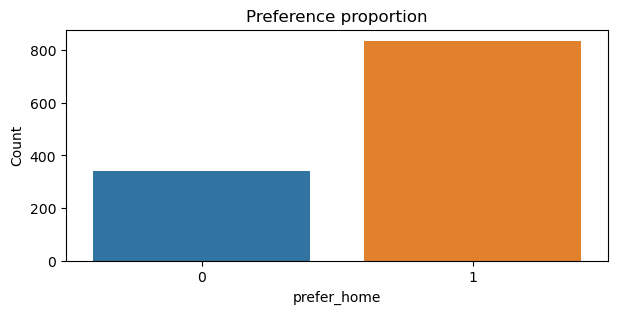

In [16]:
plt.figure(figsize=(7,3))
plt.title("Preference proportion")
sns.countplot(x=df['prefer_home'], data = df)
plt.ylabel("Count")
plt.show()

- We could say that this dataset is a bit imbalanced after seeing the graph above
- For this reason, we are going to use f1 as the metric to maximize since it works better than other metrics when we are dealing with unbalanced datasets

In [17]:
df.Male.value_counts()

1    657
0    518
Name: Male, dtype: int64

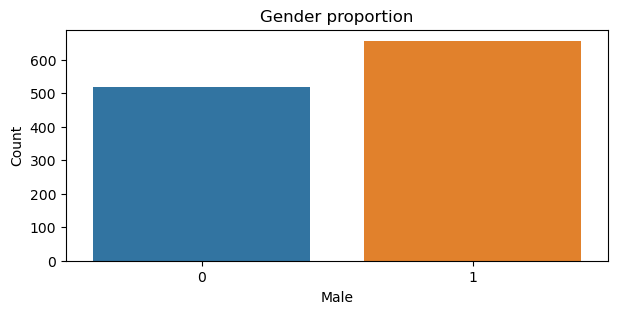

In [18]:
plt.figure(figsize=(7,3))
plt.title("Gender proportion")
sns.countplot(x=df['Male'], data = df)
plt.ylabel("Count")
plt.show()

<Axes: xlabel='Male', ylabel='count'>

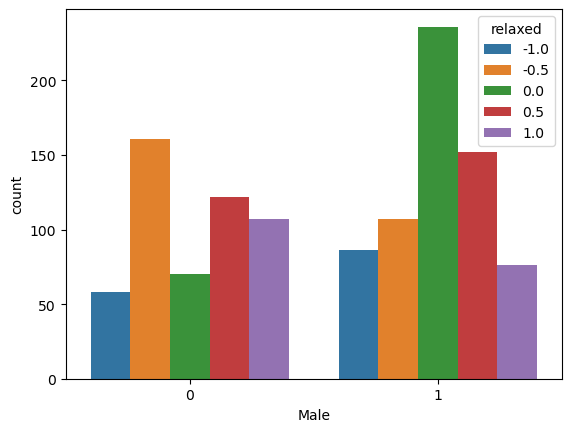

In [19]:
sns.countplot(x=df['Male'], data = df, hue = df['relaxed'])

- We can notice from this graph that, on average, women are slightly less relaxed than men for this given sample
- It would be interesting to see if, given different contexts, this result still holds and we can say that women are less propense to feeling 'relaxed' in comparison to men

<Axes: xlabel='Male', ylabel='count'>

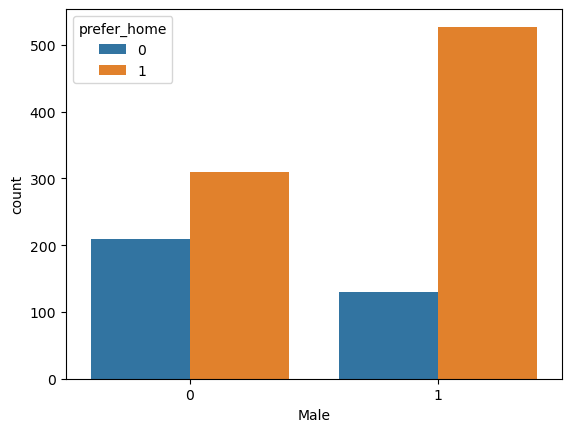

In [20]:
sns.countplot(x=df['Male'], data = df, hue = df['prefer_home'])

- Based on what we see on the graph above, males are proportionally more in favor of Physical Attendance in the office versus home office, while women are relatively more balanced
- Both genders prefer to go to the office versus working from their homes

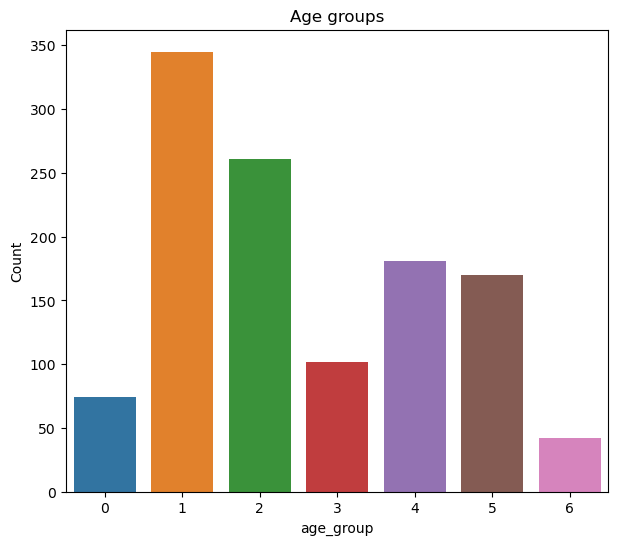

In [21]:
plt.figure(figsize=(7,6))
plt.title("Age groups")
sns.countplot(x=df['age_group'], data = df)
plt.ylabel("Count")
plt.show()

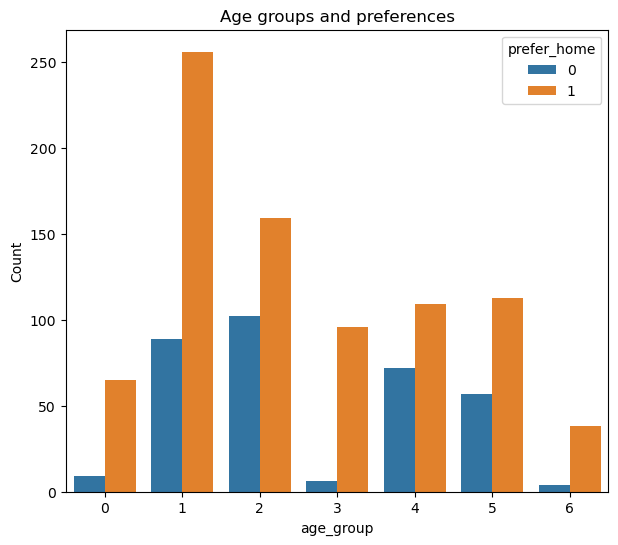

In [22]:
plt.figure(figsize=(7,6))
plt.title("Age groups and preferences")
sns.countplot(x=df['age_group'], data = df, hue = df['prefer_home'])
plt.ylabel("Count")
plt.show()

 - Something that caught my attention from this graph is that for age group 1 (19-25 yrs old), the differential of working in the office versus working from home is nominally and proportionally very high. This seem counterintuitive to me, as I would have assumed that most young adults would prefer the commodity of working from home
 - Alternatively, people aged between 40-50 years old seem to display more mixed opinions on home office regimes, as the differential is proportionally smaller than other categories

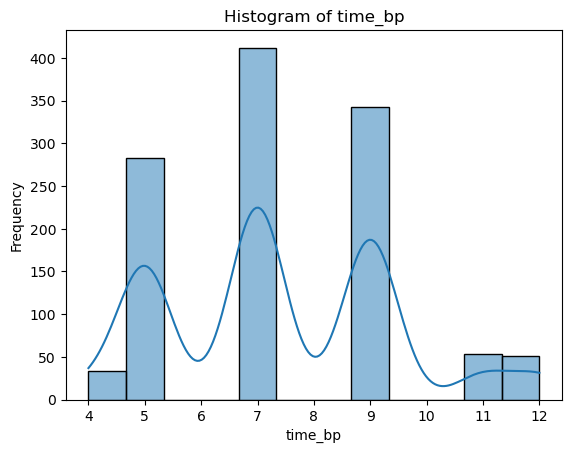

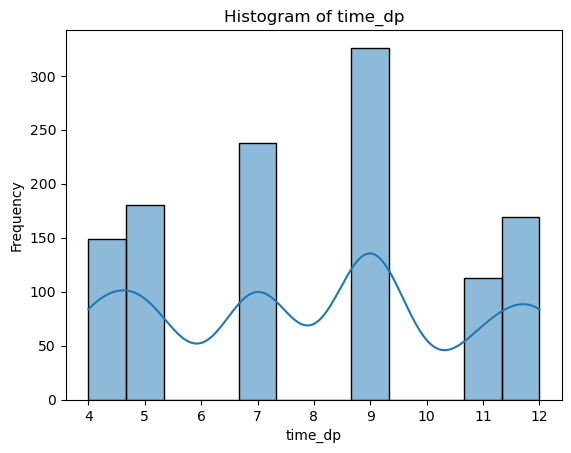

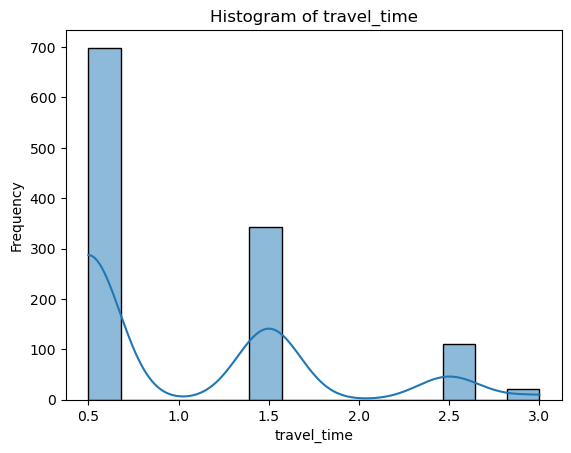

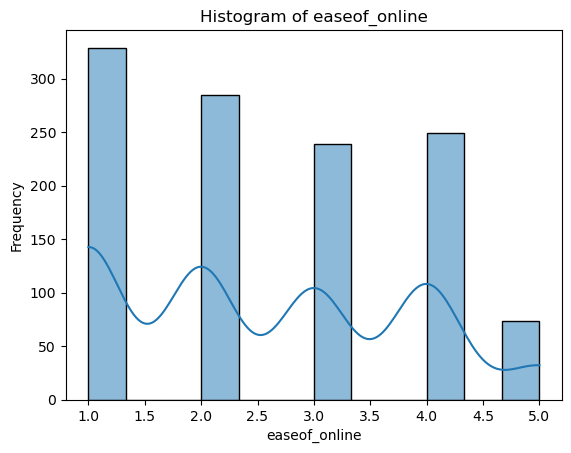

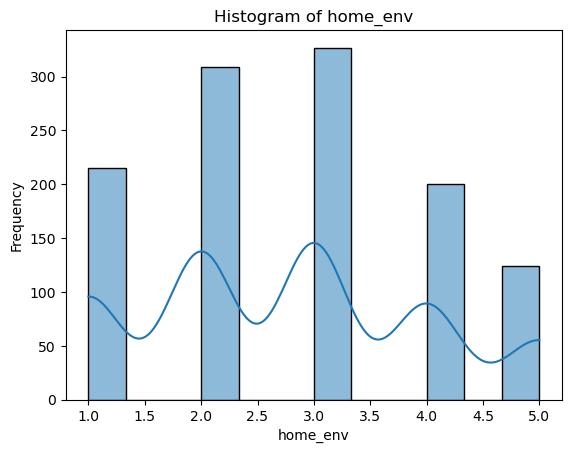

...

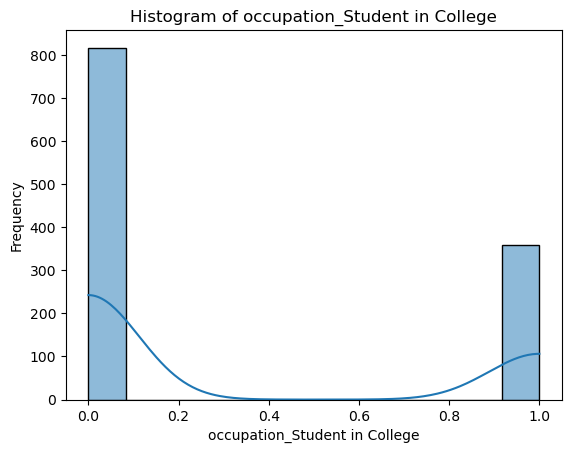

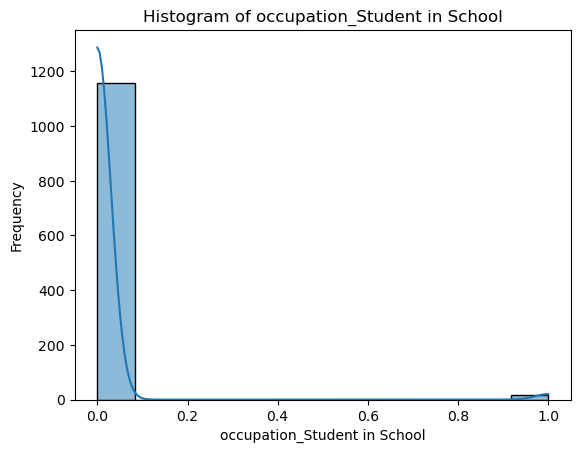

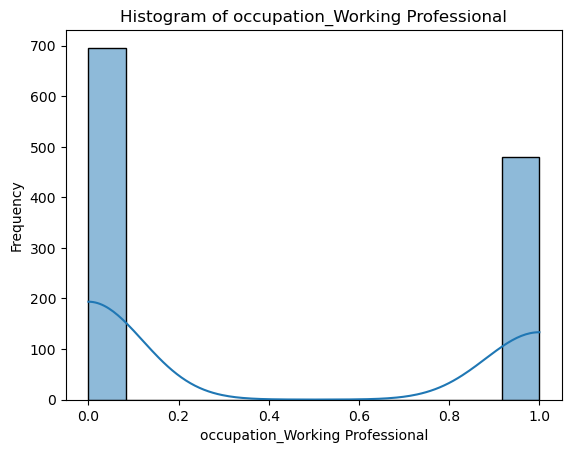

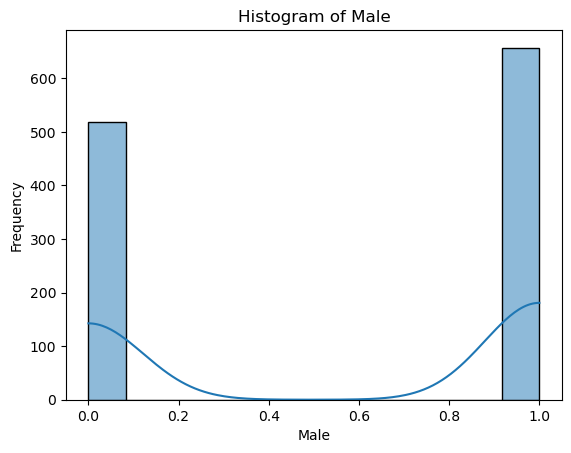

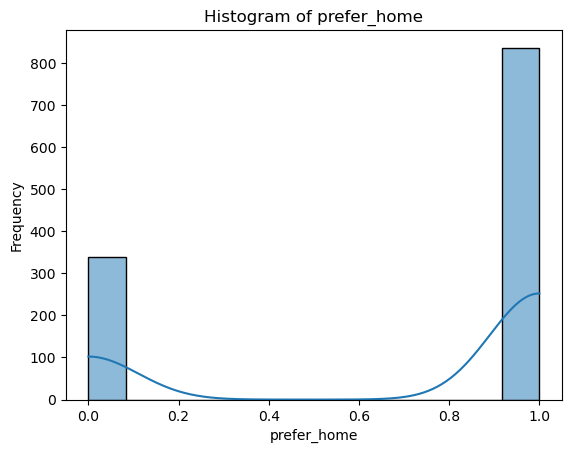

In [23]:
for col in df.columns:
    sns.histplot(data=df[col], kde=True)  # You can adjust kde parameter if needed
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

In [24]:
correlation = df.corr()

<Axes: >

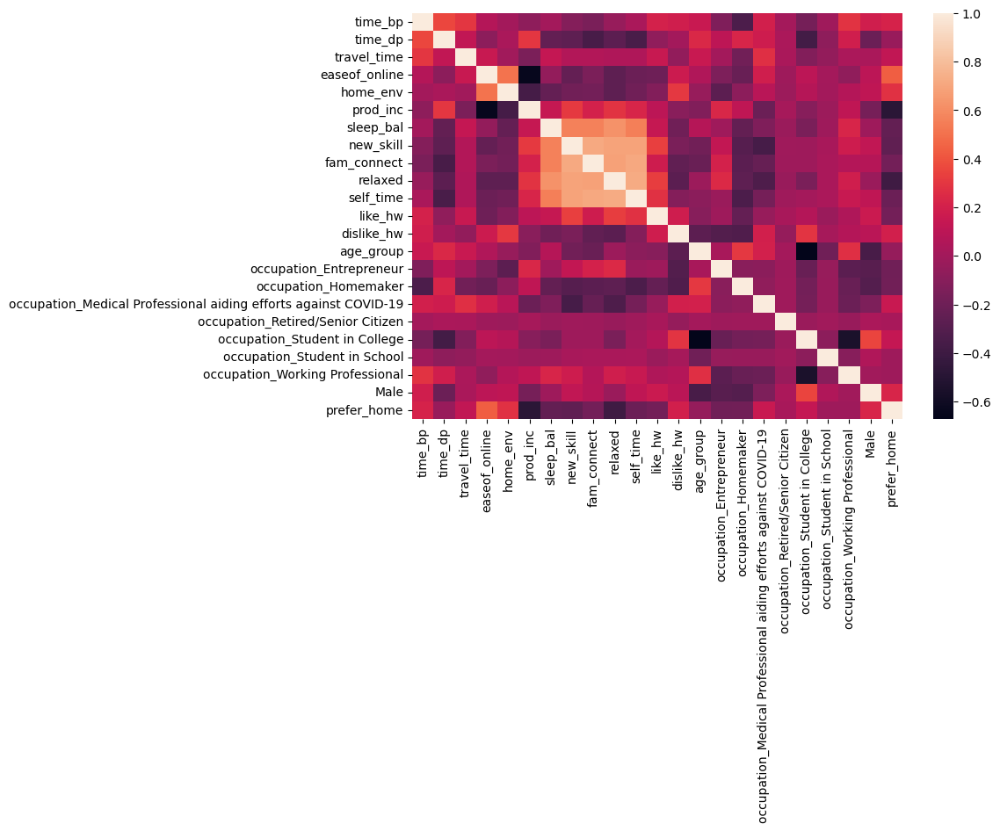

In [25]:
plt.figure(figsize=(9, 6))
sns.heatmap(data = correlation, annot=False)

- We find that some variables are positively correlated. One example is the relationship between the 'relaxation score' and the amount of new skills learnt, which is intuitive as it might be complicated to fully learn a new concept while being stressed or worried about other things
- One interesting negative correlation is the one between the 'ease of online work' (a rating of how easy is to work from home) and the productivity increase. Since we are not sure if the productivity increase is measured by their actual productivity increase or by each of the observation's perception of their productivity increase, we cannot fully conclude anything, but still it seems suspicious to me

# Modeling

## Objective:
 - The objective of this Machine Learning project is to find a model that is able to classify if the person will opt for a 'Work from home' regime, or if the person would rather work in attendance.
 - In order to do this, we are first going to try out twelve different classification algorithms. Then we are going to fine-tune the hyperparameters to achieve optimal performance
 - The metric that we are going to optimize for is f1 since it is best suited for imbalanced datasets like this one
 - We will then get the Permutation Feature Invariance values to understand which features are important and which are irrelevant. If there are any irrelevant features we shall remove them and re-run the fine-tuned model.
 - Finally, we will plot the confusion matrix to have a better understanding of the results

### Train/Validation/Test split

In [26]:
from sklearn.model_selection import train_test_split

In [27]:
X = df.drop('prefer_home', axis=1)
y = df['prefer_home']

In [28]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [29]:
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, ExtraTreesClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.neural_network import MLPClassifier

In [30]:
def metrics(model_name, y_pred, y_test):
    accuracy = accuracy_score(y_test, y_pred)
    recall_macro = recall_score(y_test, y_pred, average='macro')
    precision_macro = precision_score(y_test, y_pred, average='macro')
    f1_macro = f1_score(y_test, y_pred, average='macro')
    
    print(f"Evaluation Metrics for {model_name}:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Macro-averaged Recall: {recall_macro:.4f}")
    print(f"Macro-averaged Precision: {precision_macro:.4f}")
    print(f"Macro-averaged F1 Score: {f1_macro:.4f}")

## Logistic Regression

In [31]:
pipeline_lr = Pipeline([
    ('scaler', StandardScaler()),   
    ('lr', LogisticRegression())  
])

pipeline_lr.fit(X_train, y_train)
pred_lr = pipeline_lr.predict(X_test)


In [32]:
metrics('Logistic Regression', pred_lr, y_test)

Evaluation Metrics for Logistic Regression:
Accuracy: 0.8383
Macro-averaged Recall: 0.7889
Macro-averaged Precision: 0.7950
Macro-averaged F1 Score: 0.7919


## Decision Tree

In [33]:
pipeline_dt = Pipeline([
    ('scaler', StandardScaler()),   
    ('dt', DecisionTreeClassifier())  
])

pipeline_dt.fit(X_train, y_train)
pred_dt = pipeline_dt.predict(X_test)


In [34]:
metrics("Decision Tree", pred_dt, y_test)

Evaluation Metrics for Decision Tree:
Accuracy: 0.9149
Macro-averaged Recall: 0.8765
Macro-averaged Precision: 0.9021
Macro-averaged F1 Score: 0.8881


## Random Forest

In [35]:
pipeline_rf = Pipeline([
    ('scaler', StandardScaler()),   
    ('rf', RandomForestClassifier())  
])

pipeline_rf.fit(X_train, y_train)
pred_rf = pipeline_rf.predict(X_test)

In [36]:
metrics('Random Forest', pred_rf, y_test)

Evaluation Metrics for Random Forest:
Accuracy: 0.9362
Macro-averaged Recall: 0.8910
Macro-averaged Precision: 0.9453
Macro-averaged F1 Score: 0.9137


## Gradient Boosted Trees

In [37]:
pipeline_gb = Pipeline([
    ('scaler', StandardScaler()),   
    ('gb', GradientBoostingClassifier())  
])

pipeline_gb.fit(X_train, y_train)
pred_gb = pipeline_gb.predict(X_test)

In [38]:
metrics('Gradient Boosted Trees', pred_gb, y_test)

Evaluation Metrics for Gradient Boosted Trees:
Accuracy: 0.9404
Macro-averaged Recall: 0.9040
Macro-averaged Precision: 0.9422
Macro-averaged F1 Score: 0.9208


## Extreme Gradient Boosted Trees

In [39]:
pipeline_xgb = Pipeline([
    ('scaler', StandardScaler()),   
    ('xgb', XGBClassifier())  
])

pipeline_xgb.fit(X_train, y_train)
pred_xgb = pipeline_xgb.predict(X_test)

In [40]:
metrics('Extreme Gradient Boosted Trees', pred_xgb, y_test)

Evaluation Metrics for Extreme Gradient Boosted Trees:
Accuracy: 0.9191
Macro-averaged Recall: 0.8894
Macro-averaged Precision: 0.9019
Macro-averaged F1 Score: 0.8954


## Light Gradient Boosted Trees

In [41]:
pipeline_lgb = Pipeline([
    ('scaler', StandardScaler()),   
    ('lgb', LGBMClassifier())  
])

pipeline_lgb.fit(X_train, y_train)
pred_lgb = pipeline_lgb.predict(X_test)

[LightGBM] [Info] Number of positive: 664, number of negative: 276
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 125
[LightGBM] [Info] Number of data points in the train set: 940, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.706383 -> initscore=0.877881
[LightGBM] [Info] Start training from score 0.877881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


  File "C:\Users\manul\anaconda3\lib\site-packages\joblib\externals\loky\backend\context.py", line 245, in _count_physical_cores
    raise ValueError(


In [42]:
metrics('Light Gradient Boosted Trees', pred_lgb, y_test)

Evaluation Metrics for Light Gradient Boosted Trees:
Accuracy: 0.9234
Macro-averaged Recall: 0.8873
Macro-averaged Precision: 0.9137
Macro-averaged F1 Score: 0.8993


## Cat Boost Classifier

In [43]:
pipeline_cb = Pipeline([
    ('scaler', StandardScaler()),   
    ('cb', CatBoostClassifier())  
])

pipeline_cb.fit(X_train, y_train)
pred_cb = pipeline_cb.predict(X_test)

Learning rate set to 0.010034
0:	learn: 0.6811151	total: 145ms	remaining: 2m 24s
1:	learn: 0.6694189	total: 156ms	remaining: 1m 18s
2:	learn: 0.6568566	total: 165ms	remaining: 54.9s
3:	learn: 0.6452213	total: 172ms	remaining: 42.9s
4:	learn: 0.6331573	total: 177ms	remaining: 35.1s
5:	learn: 0.6221267	total: 180ms	remaining: 29.8s
6:	learn: 0.6103251	total: 183ms	remaining: 26s
7:	learn: 0.6008551	total: 187ms	remaining: 23.2s
8:	learn: 0.5907394	total: 190ms	remaining: 20.9s
9:	learn: 0.5817048	total: 192ms	remaining: 19s
10:	learn: 0.5759516	total: 194ms	remaining: 17.5s
11:	learn: 0.5678922	total: 196ms	remaining: 16.2s
12:	learn: 0.5597652	total: 199ms	remaining: 15.1s
13:	learn: 0.5503638	total: 202ms	remaining: 14.2s
14:	learn: 0.5422157	total: 206ms	remaining: 13.5s
15:	learn: 0.5332001	total: 208ms	remaining: 12.8s
16:	learn: 0.5251558	total: 210ms	remaining: 12.1s
17:	learn: 0.5175851	total: 212ms	remaining: 11.6s
18:	learn: 0.5099024	total: 214ms	remaining: 11.1s
19:	learn: 0.

In [44]:
metrics('Cat Boosted Trees', pred_cb, y_test)

Evaluation Metrics for Cat Boosted Trees:
Accuracy: 0.9362
Macro-averaged Recall: 0.8910
Macro-averaged Precision: 0.9453
Macro-averaged F1 Score: 0.9137


## Ada Boost Classifier

In [45]:
pipeline_ab = Pipeline([
    ('scaler', StandardScaler()),   
    ('ab', AdaBoostClassifier())  
])

pipeline_ab.fit(X_train, y_train)
pred_ab = pipeline_ab.predict(X_test)

In [46]:
metrics('Ada Boosted Trees', pred_ab, y_test)

Evaluation Metrics for Ada Boosted Trees:
Accuracy: 0.8979
Macro-averaged Recall: 0.8598
Macro-averaged Precision: 0.8755
Macro-averaged F1 Score: 0.8672


## Extra Trees Classifier

In [47]:
pipeline_xt = Pipeline([
    ('scaler', StandardScaler()),   
    ('xt', ExtraTreesClassifier())  
])

pipeline_xt.fit(X_train, y_train)
pred_xt = pipeline_xt.predict(X_test)

In [48]:
metrics('Extra Trees Classifier', pred_xt, y_test)

Evaluation Metrics for Extra Trees Classifier:
Accuracy: 0.9362
Macro-averaged Recall: 0.8910
Macro-averaged Precision: 0.9453
Macro-averaged F1 Score: 0.9137


## Support Vector Machine

In [49]:
pipeline_svc = Pipeline([
    ('scaler', StandardScaler()),   
    ('svc', SVC())  
])

pipeline_svc.fit(X_train, y_train)
pred_svc = pipeline_svc.predict(X_test)

In [50]:
metrics('Support Vector Machine', pred_svc, y_test)

Evaluation Metrics for Support Vector Machine:
Accuracy: 0.9149
Macro-averaged Recall: 0.8564
Macro-averaged Precision: 0.9237
Macro-averaged F1 Score: 0.8828


## K-Nearest Neighbors

In [51]:
pipeline_knn = Pipeline([
    ('scaler', StandardScaler()),   
    ('knn', KNeighborsClassifier())  
])

pipeline_knn.fit(X_train, y_train)
pred_knn = pipeline_knn.predict(X_test)

In [52]:
metrics('K-Nearest Neighbors', pred_knn, y_test)

Evaluation Metrics for K-Nearest Neighbors:
Accuracy: 0.9234
Macro-averaged Recall: 0.8722
Macro-averaged Precision: 0.9298
Macro-averaged F1 Score: 0.8958


## Multi-Layer Perceptron

In [53]:
pipeline_mlp = Pipeline([
    ('scaler', StandardScaler()),   
    ('mlp', MLPClassifier(max_iter = 1000))  
])

pipeline_mlp.fit(X_train, y_train)
pred_mlp = pipeline_mlp.predict(X_test)

In [54]:
metrics('Multiple Layer Perceptron', pred_mlp, y_test)

Evaluation Metrics for Multiple Layer Perceptron:
Accuracy: 0.9404
Macro-averaged Recall: 0.9140
Macro-averaged Precision: 0.9321
Macro-averaged F1 Score: 0.9225


# Hyperparameter Tuning

In [55]:
from sklearn.model_selection import GridSearchCV

In [56]:
param_grid_lr = {
    'lr__C': [0.001, 0.01, 0.1, 1, 10, 100],
    'lr__penalty': ['l1', 'l2'],
    'lr__solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}

In [57]:
grid_search_lr = GridSearchCV(pipeline_lr, param_grid_lr, cv=3, scoring = 'f1_macro')

In [58]:
grid_search_lr.fit(X_train, y_train)

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('lr', LogisticRegression())]),
             param_grid={'lr__C': [0.001, 0.01, 0.1, 1, 10, 100],
                         'lr__penalty': ['l1', 'l2'],
                         'lr__solver': ['newton-cg', 'lbfgs', 'liblinear',
                                        'sag', 'saga']},
             scoring='f1_macro')

In [59]:
best_params_lr = grid_search_lr.best_params_
best_score_lr = grid_search_lr.best_score_
lr_ht = grid_search_lr.best_estimator_
best_params_lr

{'lr__C': 0.1, 'lr__penalty': 'l1', 'lr__solver': 'liblinear'}

In [60]:
lr_ht

Pipeline(steps=[('scaler', StandardScaler()),
                ('lr',
                 LogisticRegression(C=0.1, penalty='l1', solver='liblinear'))])

In [61]:
lr_ht_pred = lr_ht.predict(X_test)

In [62]:
metrics('HT Lr', lr_ht_pred, y_test)

Evaluation Metrics for HT Lr:
Accuracy: 0.8979
Macro-averaged Recall: 0.8296
Macro-averaged Precision: 0.9043
Macro-averaged F1 Score: 0.8576


## Decision Tree

In [63]:
param_grid_dt = {
    'dt__max_depth': [None, 10, 20, 30],
    'dt__min_samples_split': [2, 5, 10],
    'dt__min_samples_leaf': [1, 2, 4]
}

grid_search_dt = GridSearchCV(pipeline_dt, param_grid_dt, cv=3, scoring = 'f1_macro')
grid_search_dt.fit(X_train, y_train)
dt_ht = grid_search_dt.best_estimator_

In [64]:
dt_ht_pred = dt_ht.predict(X_test)
metrics('HT Dt', dt_ht_pred, y_test)

Evaluation Metrics for HT Dt:
Accuracy: 0.9064
Macro-averaged Recall: 0.8707
Macro-averaged Precision: 0.8868
Macro-averaged F1 Score: 0.8782


## Random Forest

In [65]:
param_grid_rf = {
    'rf__n_estimators': [100, 200, 300],
    'rf__max_depth': [None, 10, 20, 30],
    'rf__min_samples_split': [2, 5, 10],
    'rf__min_samples_leaf': [1, 2, 4]
}

grid_search_rf = GridSearchCV(pipeline_rf, param_grid_rf, cv=3, scoring = 'f1_macro')
grid_search_rf.fit(X_train, y_train)
rf_ht = grid_search_rf.best_estimator_

In [66]:
rf_ht_pred = rf_ht.predict(X_test)
metrics('HT rf', rf_ht_pred, y_test)

Evaluation Metrics for HT rf:
Accuracy: 0.9362
Macro-averaged Recall: 0.8910
Macro-averaged Precision: 0.9453
Macro-averaged F1 Score: 0.9137


## Extreme Gradient Boosted Trees

In [67]:
param_grid_xgb = {
    'xgb__n_estimators': [100, 200, 300],
    'xgb__learning_rate': [0.01, 0.1, 0.2],
    'xgb__max_depth': [3, 4, 5],
    'xgb__min_child_weight': [1, 2, 4],
    'xgb__gamma': [0, 0.1, 0.2],
    'xgb__subsample': [0.8, 1.0],
    'xgb__colsample_bytree': [0.8, 1.0]
}

grid_search_xgb = GridSearchCV(pipeline_xgb, param_grid_xgb, cv=3, scoring = 'f1_macro')
grid_search_xgb.fit(X_train, y_train)
xgb_ht = grid_search_xgb.best_estimator_

In [68]:
grid_search_xgb.best_params_

{'xgb__colsample_bytree': 0.8,
 'xgb__gamma': 0,
 'xgb__learning_rate': 0.1,
 'xgb__max_depth': 4,
 'xgb__min_child_weight': 1,
 'xgb__n_estimators': 100,
 'xgb__subsample': 0.8}

In [69]:
xgb_ht_pred = xgb_ht.predict(X_test)
metrics('HT xgb', xgb_ht_pred, y_test)

Evaluation Metrics for HT xgb:
Accuracy: 0.9277
Macro-averaged Recall: 0.8902
Macro-averaged Precision: 0.9218
Macro-averaged F1 Score: 0.9044


## Gradient Boosted Trees

In [70]:
param_grid_gb = {
    'gb__n_estimators': [100, 200, 300],
    'gb__learning_rate': [0.01, 0.1, 0.2],
    'gb__max_depth': [3, 4, 5],
    'gb__min_samples_split': [2, 5, 10],
    'gb__min_samples_leaf': [1, 2, 4]
}

grid_search_gb = GridSearchCV(pipeline_gb, param_grid_gb, cv=3, scoring = 'f1_macro')
grid_search_gb.fit(X_train, y_train)
gb_ht = grid_search_gb.best_estimator_

In [71]:
gb_ht_pred = gb_ht.predict(X_test)
metrics('HT gb', gb_ht_pred, y_test)

Evaluation Metrics for HT gb:
Accuracy: 0.9277
Macro-averaged Recall: 0.8852
Macro-averaged Precision: 0.9271
Macro-averaged F1 Score: 0.9033


## Light Gradient Boosted Trees

In [72]:
param_grid_lgb = {
    'lgb__n_estimators': [100, 200, 300],
    'lgb__learning_rate': [0.01, 0.1, 0.2],
    'lgb__max_depth': [3, 4, 5],
    'lgb__min_child_samples': [10, 20, 30],
    'lgb__subsample': [0.8, 1.0],
    'lgb__colsample_bytree': [0.8, 1.0]
}

grid_search_lgb = GridSearchCV(pipeline_lgb, param_grid_lgb, cv=3, scoring = 'f1_macro')
grid_search_lgb.fit(X_train, y_train)
lgb_ht = grid_search_lgb.best_estimator_

[LightGBM] [Info] Number of positive: 442, number of negative: 184
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 127
[LightGBM] [Info] Number of data points in the train set: 626, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.706070 -> initscore=0.876374
[LightGBM] [Info] Start training from score 0.876374
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 443, number of negative: 184
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 128
[LightGBM] [Info] Number of data 

In [73]:
lgb_ht_pred = lgb_ht.predict(X_test)
metrics('HT gb', lgb_ht_pred, y_test)

Evaluation Metrics for HT gb:
Accuracy: 0.9277
Macro-averaged Recall: 0.8902
Macro-averaged Precision: 0.9218
Macro-averaged F1 Score: 0.9044


## Cat Boost

In [74]:
param_grid_cb = {
    'cb__iterations': [100, 200, 300],
    'cb__learning_rate': [0.01, 0.1, 0.2],
    'cb__depth': [3, 4, 5],
    'cb__l2_leaf_reg': [1, 3, 5],
    'cb__border_count': [32, 64, 128]
}

grid_search_cb = GridSearchCV(pipeline_cb, param_grid_cb, cv=3, scoring = 'f1_macro')
grid_search_cb.fit(X_train, y_train)
cb_ht = grid_search_cb.best_estimator_

0:	learn: 0.6859542	total: 2.18ms	remaining: 216ms
1:	learn: 0.6785815	total: 4.37ms	remaining: 214ms
2:	learn: 0.6730200	total: 6.09ms	remaining: 197ms
3:	learn: 0.6654918	total: 7.82ms	remaining: 188ms
4:	learn: 0.6593205	total: 9.96ms	remaining: 189ms
5:	learn: 0.6509509	total: 12.3ms	remaining: 192ms
6:	learn: 0.6430066	total: 14.7ms	remaining: 196ms
7:	learn: 0.6358772	total: 16.7ms	remaining: 192ms
8:	learn: 0.6282793	total: 18.5ms	remaining: 187ms
9:	learn: 0.6222307	total: 20.2ms	remaining: 182ms
10:	learn: 0.6153313	total: 22ms	remaining: 178ms
11:	learn: 0.6097302	total: 23.7ms	remaining: 174ms
12:	learn: 0.6054426	total: 25.8ms	remaining: 172ms
13:	learn: 0.5980139	total: 28.4ms	remaining: 174ms
14:	learn: 0.5919699	total: 30ms	remaining: 170ms
15:	learn: 0.5848485	total: 31.6ms	remaining: 166ms
16:	learn: 0.5792862	total: 33.2ms	remaining: 162ms
17:	learn: 0.5736490	total: 34.6ms	remaining: 158ms
18:	learn: 0.5664802	total: 36.1ms	remaining: 154ms
19:	learn: 0.5613557	total

In [75]:
grid_search_cb.best_params_

{'cb__border_count': 32,
 'cb__depth': 3,
 'cb__iterations': 200,
 'cb__l2_leaf_reg': 5,
 'cb__learning_rate': 0.2}

In [76]:
cb_ht_pred = cb_ht.predict(X_test)
metrics('HT cb', cb_ht_pred, y_test)

Evaluation Metrics for HT cb:
Accuracy: 0.9447
Macro-averaged Recall: 0.9069
Macro-averaged Precision: 0.9511
Macro-averaged F1 Score: 0.9260


## Ada Boost

In [77]:
param_grid_ab = {
    'ab__n_estimators': [50, 100, 200],
    'ab__learning_rate': [0.01, 0.1, 0.2]
}

grid_search_ab = GridSearchCV(pipeline_ab, param_grid_ab, cv=3, scoring = 'f1_macro')
grid_search_ab.fit(X_train, y_train)
ab_ht = grid_search_ab.best_estimator_

In [78]:
ab_ht_pred = ab_ht.predict(X_test)
metrics('HT ab', ab_ht_pred, y_test)

Evaluation Metrics for HT ab:
Accuracy: 0.9149
Macro-averaged Recall: 0.8513
Macro-averaged Precision: 0.9309
Macro-averaged F1 Score: 0.8813


## Extra Trees Classifier

In [79]:
param_grid_xt = {
    'xt__n_estimators': [50, 100, 200],
    'xt__max_depth': [None, 10, 20, 30],
    'xt__min_samples_split': [2, 5, 10],
    'xt__min_samples_leaf': [1, 2, 4]
}

grid_search_xt = GridSearchCV(pipeline_xt, param_grid_xt, cv=3, scoring = 'f1_macro')
grid_search_xt.fit(X_train, y_train)
xt_ht = grid_search_xt.best_estimator_

In [80]:
xt_ht_pred = xt_ht.predict(X_test)
metrics('HT xt', xt_ht_pred, y_test)

Evaluation Metrics for HT xt:
Accuracy: 0.9277
Macro-averaged Recall: 0.8751
Macro-averaged Precision: 0.9395
Macro-averaged F1 Score: 0.9010


## Support Vector Machine

In [81]:
param_grid_svc = {
    'svc__C': [0.1, 1, 10],
    'svc__kernel': ['linear', 'rbf'],
    'svc__gamma': ['scale', 'auto']
}

grid_search_svc = GridSearchCV(pipeline_svc, param_grid_svc, cv=3, scoring = 'f1_macro')
grid_search_svc.fit(X_train, y_train)
svc_ht = grid_search_svc.best_estimator_

In [82]:
svc_ht_pred = svc_ht.predict(X_test)
metrics('HT svc', xt_ht_pred, y_test)

Evaluation Metrics for HT svc:
Accuracy: 0.9277
Macro-averaged Recall: 0.8751
Macro-averaged Precision: 0.9395
Macro-averaged F1 Score: 0.9010


## k-Nearest Neighbors

In [83]:
param_grid_knn = {
    'knn__n_neighbors': [3, 5, 7],
    'knn__weights': ['uniform', 'distance'],
    'knn__p': [1, 2]
}

grid_search_knn = GridSearchCV(pipeline_knn, param_grid_knn, cv=3, scoring = 'f1_macro')
grid_search_knn.fit(X_train, y_train)
knn_ht = grid_search_knn.best_estimator_

In [84]:
knn_ht_pred = knn_ht.predict(X_test)
metrics('HT svc', knn_ht_pred, y_test)

Evaluation Metrics for HT svc:
Accuracy: 0.9362
Macro-averaged Recall: 0.9011
Macro-averaged Precision: 0.9336
Macro-averaged F1 Score: 0.9156


## Multi-Layer Perceptron

In [85]:
param_grid_mlp = {
    'mlp__hidden_layer_sizes': [(50,), (100,), (50, 50)],
    'mlp__activation': ['relu', 'logistic'],
    'mlp__alpha': [0.0001, 0.001, 0.01],
    'mlp__learning_rate': ['constant', 'adaptive']
}

grid_search_mlp = GridSearchCV(pipeline_mlp, param_grid_mlp, cv=3, scoring = 'f1_macro')
grid_search_mlp.fit(X_train, y_train)
mlp_ht = grid_search_mlp.best_estimator_

In [86]:
mlp_ht_pred = mlp_ht.predict(X_test)
metrics('HT MLP', mlp_ht_pred, y_test)

Evaluation Metrics for HT MLP:
Accuracy: 0.9489
Macro-averaged Recall: 0.9199
Macro-averaged Precision: 0.9484
Macro-averaged F1 Score: 0.9329


In [87]:
grid_search_mlp.best_params_

{'mlp__activation': 'logistic',
 'mlp__alpha': 0.001,
 'mlp__hidden_layer_sizes': (100,),
 'mlp__learning_rate': 'constant'}

In [88]:
from sklearn.model_selection import cross_val_score

def run_cross_validation(model, X, y, cv=5, scoring='f1'):
    scores = cross_val_score(model, X, y, cv=cv, scoring=scoring)
    return scores, scores.mean()

In [89]:
run_cross_validation(mlp_ht, X_test, y_test)

(array([0.90666667, 0.88571429, 0.91666667, 0.92957746, 0.96969697]),
 0.9216644107066643)

# Permutation Feature Invariance

In [90]:
from sklearn.inspection import permutation_importance
import numpy as np

In [91]:
model = CatBoostClassifier(border_count = 32, depth = 3, iterations = 200, l2_leaf_reg = 5, learning_rate = 0.2)
model.fit(X_train, y_train)
result = permutation_importance(model, X_test, y_test, n_repeats=30, random_state=42)

0:	learn: 0.5698506	total: 1.6ms	remaining: 319ms
1:	learn: 0.4910406	total: 3.27ms	remaining: 324ms
2:	learn: 0.4266476	total: 4.66ms	remaining: 306ms
3:	learn: 0.3840676	total: 6.29ms	remaining: 308ms
4:	learn: 0.3388563	total: 8.8ms	remaining: 343ms
5:	learn: 0.3088964	total: 10.6ms	remaining: 341ms
6:	learn: 0.2889757	total: 12.1ms	remaining: 333ms
7:	learn: 0.2728512	total: 13.7ms	remaining: 330ms
8:	learn: 0.2651809	total: 15.4ms	remaining: 328ms
9:	learn: 0.2584539	total: 17.1ms	remaining: 326ms
10:	learn: 0.2534332	total: 18.9ms	remaining: 325ms
11:	learn: 0.2457704	total: 20.7ms	remaining: 325ms
12:	learn: 0.2382077	total: 22.6ms	remaining: 325ms
13:	learn: 0.2334717	total: 24.9ms	remaining: 330ms
14:	learn: 0.2268884	total: 26.7ms	remaining: 329ms
15:	learn: 0.2225981	total: 28.4ms	remaining: 327ms
16:	learn: 0.2193807	total: 30.1ms	remaining: 324ms
17:	learn: 0.2149948	total: 31.7ms	remaining: 321ms
18:	learn: 0.2096936	total: 33.4ms	remaining: 318ms
19:	learn: 0.2075215	tot

In [92]:
feature_importance = result.importances_mean
feature_names = df.columns

In [93]:
for feature, importance in zip(feature_names, feature_importance):
    print(f"{feature}: {importance}")

time_bp: 0.00822695035460994
time_dp: 0.015035460992907822
travel_time: 0.0028368794326241176
easeof_online: 0.02851063829787238
home_env: 0.012198581560283705
prod_inc: 0.04184397163120573
sleep_bal: 0.004255319148936176
new_skill: 0.00893617021276597
fam_connect: 0.0007092198581560294
relaxed: 0.03248226950354614
self_time: 0.0063829787234042645
like_hw: 0.02482269503546103
dislike_hw: 0.029078014184397205
age_group: 0.01900709219858159
occupation_Entrepreneur: 0.0
occupation_Homemaker: 0.0005673758865248236
occupation_Medical Professional aiding efforts against COVID-19: 0.0
occupation_Retired/Senior Citizen: 0.0
occupation_Student in College: 0.0
occupation_Student in School: 0.004255319148936176
occupation_Working Professional: 0.0
Male: 0.010921985815602853


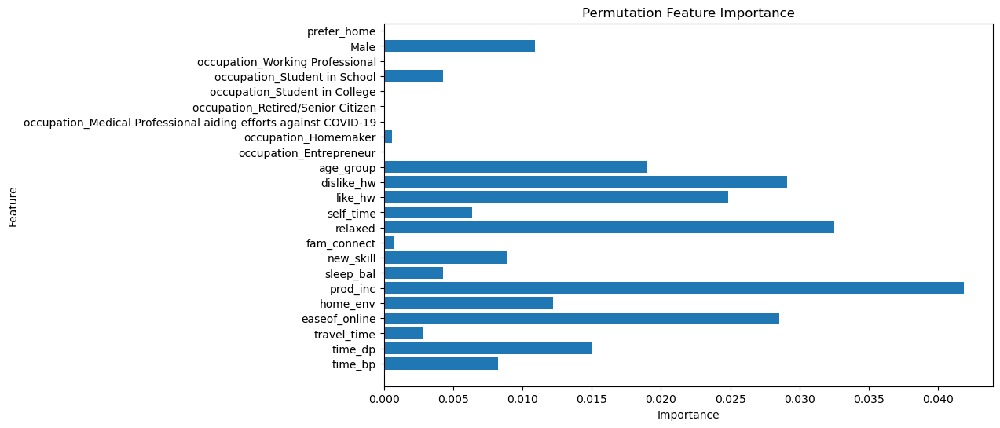

In [94]:
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_importance)), feature_importance, align='center')
plt.yticks(range(len(feature_importance) + 1), feature_names)
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Permutation Feature Importance')
plt.show()

- From what we see in the graph from the feature importances it looks like Productivity increase, the 'Relaxation' rate, and the 'Disliking' of working from home seem to be the most important features in order to predict whether the person will prefer to work under a home office or physical attendance work regime
- Something that seems interesting is that, for some reason, the fact that someone dislikes working from home is 'stronger' that someone saying they like working from home when predicting whether they prefer the different regimes
- Occupation in general seems to not have a significant effect on the prediction of the preference of the working regime of that person

# Feature selection and final run

In [95]:
X_eng = df.drop(columns = ['prefer_home', 'new_skill', 'occupation_Retired/Senior Citizen',
                          'occupation_Medical Professional aiding efforts against COVID-19', 'occupation_Working Professional',
                          'occupation_Student in College', 'occupation_Homemaker', 'occupation_Entrepreneur', 'fam_connect'])
y_eng = df['prefer_home']

In [96]:
X_eng_train, X_eng_test, y_eng_train, y_eng_test = train_test_split(X_eng, y_eng, test_size=0.2, random_state=42)

In [97]:
scaler = StandardScaler()

scaler.fit(X_eng_train)

X_eng_train_scaled = scaler.transform(X_eng_train)

X_eng_test_scaled = scaler.transform(X_eng_test)

In [98]:
model = CatBoostClassifier(border_count = 32, depth = 3, iterations = 200, l2_leaf_reg = 5, learning_rate = 0.2)

In [99]:
model.fit(X_eng_train, y_eng_train)

0:	learn: 0.5612463	total: 1.52ms	remaining: 302ms
1:	learn: 0.4877547	total: 3.37ms	remaining: 333ms
2:	learn: 0.4002990	total: 4.97ms	remaining: 327ms
3:	learn: 0.3481373	total: 6.57ms	remaining: 322ms
4:	learn: 0.3246244	total: 7.95ms	remaining: 310ms
5:	learn: 0.3097684	total: 9.47ms	remaining: 306ms
6:	learn: 0.2964269	total: 12.4ms	remaining: 343ms
7:	learn: 0.2866326	total: 13.9ms	remaining: 334ms
8:	learn: 0.2728525	total: 15.2ms	remaining: 322ms
9:	learn: 0.2642891	total: 16.4ms	remaining: 312ms
10:	learn: 0.2575256	total: 17.8ms	remaining: 305ms
11:	learn: 0.2492251	total: 19.1ms	remaining: 300ms
12:	learn: 0.2424306	total: 20.6ms	remaining: 296ms
13:	learn: 0.2366702	total: 22.2ms	remaining: 295ms
14:	learn: 0.2338438	total: 23.8ms	remaining: 294ms
15:	learn: 0.2293895	total: 25.5ms	remaining: 294ms
16:	learn: 0.2243341	total: 27.4ms	remaining: 295ms
17:	learn: 0.2198124	total: 29.6ms	remaining: 299ms
18:	learn: 0.2160873	total: 31.2ms	remaining: 298ms
19:	learn: 0.2138194	t

In [100]:
model_pred = model.predict(X_eng_test)

In [101]:
metrics('Final Cat Boost Model', model_pred, y_eng_test)

Evaluation Metrics for Final Cat Boost Model:
Accuracy: 0.9191
Macro-averaged Recall: 0.8844
Macro-averaged Precision: 0.9058
Macro-averaged F1 Score: 0.8943


In [102]:
run_cross_validation(model, X_test, y_test)

0:	learn: 0.5114375	total: 1.42ms	remaining: 283ms
1:	learn: 0.4583319	total: 3.08ms	remaining: 304ms
2:	learn: 0.4029794	total: 4.46ms	remaining: 293ms
3:	learn: 0.3539900	total: 5.98ms	remaining: 293ms
4:	learn: 0.2840285	total: 7.39ms	remaining: 288ms
5:	learn: 0.2551649	total: 8.9ms	remaining: 288ms
6:	learn: 0.2220075	total: 10.7ms	remaining: 296ms
7:	learn: 0.2013397	total: 12.4ms	remaining: 298ms
8:	learn: 0.1870213	total: 14.2ms	remaining: 302ms
9:	learn: 0.1755629	total: 18.1ms	remaining: 343ms
10:	learn: 0.1650334	total: 19.5ms	remaining: 335ms
11:	learn: 0.1582073	total: 21ms	remaining: 330ms
12:	learn: 0.1481393	total: 22.6ms	remaining: 325ms
13:	learn: 0.1412830	total: 24.1ms	remaining: 321ms
14:	learn: 0.1357195	total: 26.2ms	remaining: 323ms
15:	learn: 0.1306078	total: 27.8ms	remaining: 319ms
16:	learn: 0.1234578	total: 30.2ms	remaining: 325ms
17:	learn: 0.1116247	total: 31.8ms	remaining: 322ms
18:	learn: 0.1042729	total: 33.3ms	remaining: 317ms
19:	learn: 0.1020398	tota

(array([0.88      , 0.94444444, 0.94285714, 0.93150685, 0.98507463]),
 0.9367766126964655)

# Confusion matrix

In [103]:
from sklearn.metrics import confusion_matrix

In [104]:
model_cm = confusion_matrix(y_eng_test, model_pred)

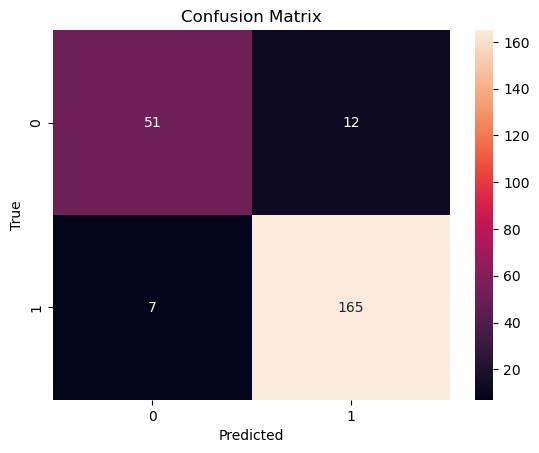

In [105]:
sns.heatmap(model_cm, annot=True, fmt="d")

# Add labels, title, and axis ticks
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")

plt.show()

# Results

- This model achieved an f1 score of approximately 93% after hyperparameter tuning and feature selection. This seems like a strong number if we compare it to the previous models. The f1 score is a metric that balances the trade-off between precision (true positives over predicted positives) and recall (true positives over actual positives), making it an informative measure of model accuracy.
- One thing that is important to note is that I also tried to run the tuned Multi Layer Perceptron model after feature selection and obtained an average f1 score of 83%. This means that this model was overfitting the data, therefore I decided to go for the second best model, the CatBoost model, to ensure a more generalizable model.
- This model is better at predicting true positives than true negatives. Alternatively, our model has more false negatives than false positives. This makes sense since the model has a higher precision than recall
- This model holds promise for research centers and Human Resources departments seeking to gauge employee sentiments toward the 'Home office' regime, a significant aspect reshaped by the COVID-19 pandemic. By understanding employee preferences, organizations can make informed decisions about remote work policies and ensure a productive work environment. It would be a good idea to compare attrition rates before and after the implementation of the model on any given company.
- There are some limitations to our model. The model does not consider some variables which, intuitively, might prove useful to predict the employee's preference. For example, it would be interesting to see if the employee has children, or what is the employee's general opinion (on a scale of 1 to 10, for example) of the public transport system, or even their perspective on the company's workspace.
- Going forward, extra data points and further improvements should be taken into consideration in order to enhance the model's performance.